# World Data League 2022

## 🎯 Challenge
Optimization of public transport routes during road interruptions by Cascais Municipality

## Team: Moons of Jupyter
## 👥 Authors
* Cristian Castro
* Tejas Choudekar
* Ajit Gupta

## 💻 Development
Start coding here! 🐱‍🏍

Create the necessary subsections (e.g. EDA, different experiments, etc..) and markdown cells to include descriptions of your work where you see fit. Comment your code. 

All new subsections must start with three hash characters.

Pro-tip 1: Don't forget to make the jury's life easier. Remove any unnecessary prints before submitting the work. Hide any long output cells (from training a model for example). For each subsection, have a quick introduction (justifying what you are about to do) and conclusion (results you got from what you did). 

Pro-tip 2: Have many similiar graphs which all tell the same story? Add them to the appendix and show only a couple of examples, with the mention that all the others are in the appendix.

### (0) Approach and Methodology

Optimization of public transport in cities is without a question a hot topic. The perfomance of the public transport has direct consequences not only in the quality of life of the citizens of each city (because of connectivity), but also in the overall CO2 emissions of an entire country. It is a big challenge to focus on. To solve a [Vehicle Routing Problem (VRP)](https://en.wikipedia.org/wiki/Vehicle_routing_problem) with the size of an entire city is a **NP-Hard problem**. This means: Easy to check once it is solved, but **very difficult and time consuming to solve it to optimality (if an optimal solution can actually be found)**. Because of this we decided to go step by step, and even before considering to go with heuristics and other methodologies, our approach and methodology was based on ***Divide and Conquer***. Our idea aims to go from general to specific, and the methodology is shown below.

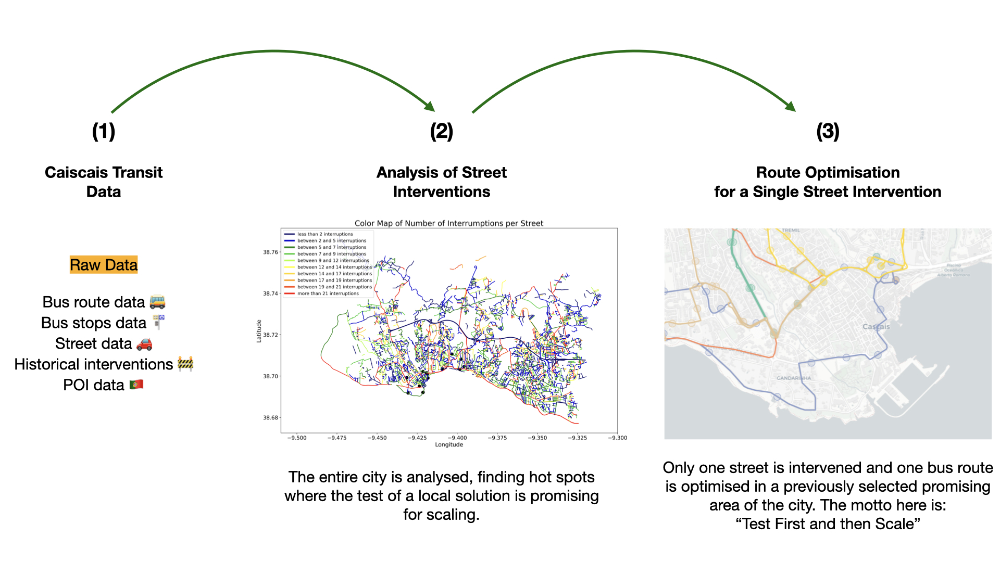
**<center>Figure 1. Proposed Methodology</center>**

From general to specific, the methodology follows the following:

1. **Caiscais Transit Data**:
    - Gather and interpret geospatial data from Caiscais Municipality
    - The data included: 
        - MNIVP Dataset: Dataset with public interventions between 2014 and 2021, with a total of 6617 registers
        - EIXODEVIA Dataset: Dataset with the streets of the city in coordinates (Longitude, Latitude)
        - MNCAUTOCARRO Dataset: Bus routes in coordinates (Longitude, Latitude)
        - GTFS Datasets: Bus routes and stops in coordinates (Longitude, Latitude)
        - POI Data: From Google Maps (Manually) POI data was obtained to check for important areas of the city.


2. **Analysis of Street Interventions**:
    - From the Caiscais data it was obtained the total number of days each street was off service (at least at one point), total number of interrumptions per street, and other type of description of the phenomenon.
    - Based on this information, one street was chosen based on its perfomance (number of interruptions) and its importance to the city (location).
    - The neighborhood of the chosen city is exported to do a route optimization for a single bus route in case of interruption occurring in this street.
    

3. **Route Optimization on a Single Street**:
    - An Optimization Model for Shortest Path (STP) using Dijsktra's Exact Algorithm is implemented in this part. This implementation considers using the neighborhood selected in part (2) as a network, and the bus route as the subject of optimization.
    - Dijkstra's algorithm for STP stands as the base case, in which the routes is optimized only considering minimization of the new alternative route. Then this algorithm was modified to include rewards by visiting the closest points to the original bus route. Then this algorithm is again modified to include also penalties for deviating too much for its original route.
    - The solutions promise good future scaling for the entire city.

**Please go to File and Trust the Notebook to see the maps and interactive graphs.**

or you can find our solutions in this one drive: https://1drv.ms/u/s!As6If4VOzmiPhKR8LoDbhQVSxUjoqw?e=aLKYQH

In [1]:
# Libraries
import sys
from pathlib import Path

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import seaborn as sns

import geopandas as gp
import geojson
from shapely.geometry import LineString, shape
import fiona
import contextily as cx
from fastai.imports import *
import gtfs_kit as gk
import folium
import json
import gtfsutils
import gtfsutils.routes
import gtfsutils.filter
from geojson import Feature, FeatureCollection, Point
from obspy.geodetics import degrees2kilometers
from geopy import distance
from collections import defaultdict

import warnings
warnings.filterwarnings("ignore")

### (1) Exploratory Data Analysis
#### 1.1 Data Preprocessing
The following files were preprocessed as described:
1. eixodevia.geojson:
    - As geojson data, the file needed some corrections to make it redable to geopandas library. 
    - In the feature geometry there was one extra set of brackets that the library misunderstood as empty string eventhough the data was given. After deleting the extra (unnecessary) set of brackets the code worked as a charm.
    - For example below was the original data:
        - "geometry": {{"type": "LineString","coordinates": [[-9.3907362281, 38.7355689813],[-9.3912515233, 38.7355664987]]}}
        - In this example there are two curly braces '{}' after geometry which is incorrect.
    - Geopandas need it to be in below format:
        - "geometry": {"type": "LineString","coordinates": [[-9.3907362281, 38.7355689813],[-9.3912515233, 38.7355664987]]}
        
        
2. mnivp.csv:
    - The portuguese characters of the street names were change to standard english, to avoid mis-manipulation.
    - 54 points have end date before start date. We assumed that it was a typo mistake, and inverted them.
    - Interventions without start and end dates were deleted (31 points)
    - Columns 'Temporary reception', 'Final reception' and 'Process number' were deleted for having more than 10% missing values.
    - Interventions without street names were deleted (56 points)

#### 1.2 Caiscais City Network

Caiscais is a city in Portugal (near Lisbon), which has **987 registered different streets** as it can be seen below.

In [2]:
geo_data = gp.read_file('eixodevia.geojson', 
                        ignore_geometry = False, 
                        encoding = 'utf-8')

geo_data.explore(color = 'darkslategray')

Caiscais contains **44 bus routes** to give the city connectivity. In total, these 44 bus routes traverse the city through **1043 bus stops**. Their routes and stops in the city (what we call Caiscais City Network) can be seen below.

In [3]:
# Declare the directory path for the GTFS zip file
path = Path("cascais.zip")

# Read the feed with gtfs-kit
feed = (gk.read_feed(path, dist_units='km'))

# Search for errors and warnings in the feed
feed.validate()

# Check for errors in routes by plotting them to a map
feed.map_routes(feed.routes.route_id.iloc[:], include_stops = True)

With this exploratory analysis of the public transport of the city of Caiscais, we can have an idea of the size and magnitude of the problem. **This confirms our approach**. In order to pursue further, we need to select a promising area to prove our hypothesis. To do so, it is necessary to analise the data related to the interruptions/interventions of the streets of Caiscais.

### (2) Caiscais Street Interventions Analysis
The data contains all interventions that took place in the streets of Caiscais during the period 2013 - 2021, which in total **sum 6516 data points (single interventions)**. For simplicity, we assumed that any intervention occurring in a street involves the detention of that street. This means that whenever an intervention takes place, the transit through that street halts.

In [4]:
# Interventions data
mnivp = pd.read_csv('mnivp.csv', 
                    sep = ';',
                    header = 0,
                    names = ['id',
                             'applicant',
                             'type of working',
                             'street',
                             'county',
                             'actualization',
                             'start',
                             'end',
                             'process number',
                             'status',
                             'temporary reception',
                             'year',
                             'final reception']
                   )

# Change dates to datetime
mnivp['start'] = pd.to_datetime(mnivp['start'].astype(str), format = '%d-%m-%Y', errors = 'coerce')
mnivp['end'] = pd.to_datetime(mnivp['end'].astype(str), format = '%d-%m-%Y', errors = 'coerce')

# Correct typo when Start date comes later as End date
for ii in range(0, len(mnivp)):
    start = mnivp.iloc[ii,6]
    end = mnivp.iloc[ii,7]
    if start > end:
        mnivp.iloc[ii,6] = end
        mnivp.iloc[ii,7] = start

# Delete data points without start or end data
mnivp.dropna(subset=['start', 'end'], inplace = True)

# Delete data points without street name
mnivp.dropna(subset=['street'], inplace = True)

# Delete columns with more than 10% missing data (previously visualized)
mnivp.drop(['final reception','temporary reception','process number'], inplace = True, axis = 1)

# Refill Year in 3 data points with the missing year 
values = {"year": '2020'}
mnivp.fillna(values, inplace = True)

# Correct missing countys
for ii in range(0, len(mnivp)):
    if mnivp.iloc[ii,3] == 'Estrada dos Bernardos':
        mnivp.iloc[ii,4] = 'Alcabideche'
    if mnivp.iloc[ii,3] == 'Rua Joaquim Ereira, n.� 1610 em Torre':
        mnivp.iloc[ii,4] = 'U.F. Cascais e Estoril'
    if mnivp.iloc[ii,3] == 'Rua Dom Diniz Bordalo Pinheiro':
        mnivp.iloc[ii,4] = 'Other'
    if mnivp.iloc[ii,3] == 'Rua da Mina':
        mnivp.iloc[ii,4] = 'Other'
    if mnivp.iloc[ii,3] == ',Rua do Grupo de Instrucao Popular, n.� 14 em Amoreira':
        mnivp.iloc[ii,3] = 'Rua do Grupo de Instrucao Popular, n.� 14 em Amoreira'

# Create off time to account for the amount of days that the street was intervened
mnivp['off'] = (mnivp['end'] - mnivp['start'])/np.timedelta64(1, 'D')

mnivp.head()

,id,applicant,type of working,street,county,actualization,start,end,status,year,off
0,44611945,Particular,Rede eletrica,Rua das Amendoeiras,U.F. Carcavelos e Parede,02-06-2020 09:15,2020-04-24,2020-04-24,Em execucao,2020,0.0
1,44522015,Particular,Rede eletrica,Rua do Bugio,U.F. Carcavelos e Parede,06-04-2020 13:20,2020-04-13,2020-04-14,Em execucao,2020,1.0
2,44514495,Particular,Rede eletrica,Rua das Amendoeiras,U.F. Carcavelos e Parede,12-03-2020 09:38,2020-03-16,2020-03-20,Em execucao,2020,4.0
3,46640212,Particular,Rede eletrica,"Travessa Nuno Tristao, n.1 em Murches",Alcabideche,11-05-2021 15:52,2021-05-18,2021-05-19,Em execucao,2021,1.0
4,40717062,ADC aguas de Cascais,Rede eletrica,Caminho do Uruguai,Alcabideche,24-01-2018 12:13,2018-01-29,2018-02-09,Em execucao,2018,11.0


#### 2.1 Frequency of Street Interventions
Let's see the distribution of the off time of the interventions. This means: the distribution of the times each street was off transit.

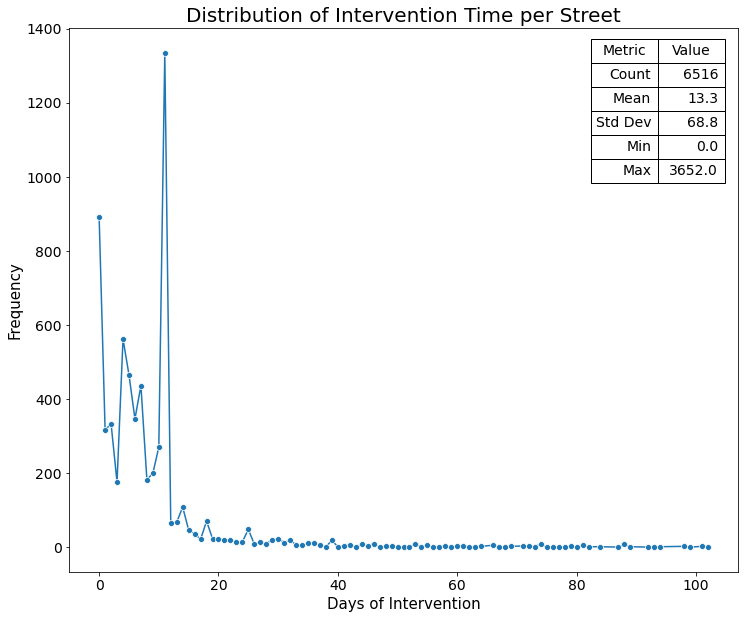

In [5]:
off_transit = pd.DataFrame(mnivp.groupby(by=['off'])['id'].count())
off_transit = off_transit.reset_index()

count = mnivp['off'].count()
mean  = round(mnivp['off'].mean(),1)
stddv = round(mnivp['off'].std(),1)
min_  = round(mnivp['off'].min(),1)
max_  = round(mnivp['off'].max(),1)

fig, ax = plt.subplots(figsize = (12,10))
sns.lineplot(x = 'off',
             y = 'id',
             data = off_transit[off_transit['off'] < 103],
             marker = 'o')
table = ax.table(cellText = [['Count', count],
                             ['Mean', mean],
                             ['Std Dev', stddv],
                             ['Min', min_],
                             ['Max', max_]], 
                 colLabels = ['Metric', 'Value'],
                 colWidths = [1/10,1/10],
                 loc = 'upper right')
table.auto_set_font_size(False)
table.set_fontsize(14)
table.scale(1, 2)
plt.title('Distribution of Intervention Time per Street', fontsize = 20)
plt.xlabel('Days of Intervention', fontsize = 15)
plt.ylabel('Frequency', fontsize = 15)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.show()

In average, the streets that have been intervened in Caiscais have been **halted for 13.3 days**. Concerning the continuity of the public transport as a system, this confirms the need to have resilient alternative mechanism to the preventive and corrective interventions of the streets in the future.

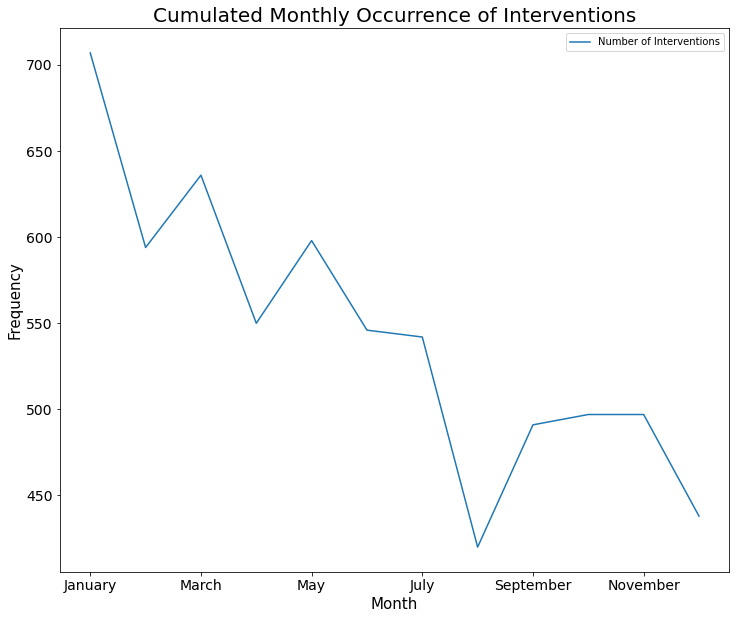

In [6]:
# Check the monthly occurrence
mnivp['month'] = mnivp['start'].dt.month_name()
sort_order = ['January', 
              'February', 
              'March', 
              'April', 
              'May', 
              'June', 
              'July', 
              'August', 
              'September', 
              'October', 
              'November', 
              'December']
plot_monthly = mnivp.groupby(by = ['month']).count()['off']
plot_monthly = plot_monthly.reset_index()
plot_monthly.index = pd.CategoricalIndex(plot_monthly['month'],
                                         categories = sort_order,
                                         ordered = True)
plot_monthly = plot_monthly.sort_index().reset_index(drop = True)

plot_monthly.plot(x = 'month',
                  y = 'off',
                  label = 'Number of Interventions',
                  figsize = (12,10))
plt.title('Cumulated Monthly Occurrence of Interventions', fontsize = 20)
plt.xlabel('Month', fontsize = 15)
plt.ylabel('Frequency', fontsize = 15)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.show()

The previous graph tells us that **most of the interventions and cuts in the streets occur during January-March**, which makes sense considering that in the winter time, less tourist visit the area, so the downsides of interventions are lesser.

#### 2.2 Interventions per Street: The Streets of the Cita as a Color Map

To account for the frequency of interventions per street, we muss work the data and then plot the geospatial data in scale.

In [7]:
# Delete the number of the interventions and sort by street, as we will treat this per street.
mnivp['street'] = mnivp['street'].str.split(pat=",", expand = True)
mnivp = mnivp.sort_values(by=['street'])

# There are duplicated street names, to we will unify. Let's lower the characters and unify
mnivp['street'] = mnivp['street'].str.lower()
ii = 0
while ii < len(mnivp)-1:
    if mnivp.iloc[ii,3].lower() in mnivp.iloc[ii+1,3].lower():
        mnivp.iloc[ii+1,3] = mnivp.iloc[ii,3]
    ii+=1

# The number of interventions per street is given by
counts = mnivp.groupby(pd.Grouper(key="street")).count()
sums = mnivp.groupby(pd.Grouper(key="street")).sum()

counts.drop(['applicant', 'type of working', 'county', 'actualization', 'start', 'end', 'status', 'year', 'off'], inplace = True, axis = 1)
sums.drop(['id'], inplace=True, axis=1)

events_per_street = pd.concat([counts, sums], axis=1)
events_per_street = events_per_street.rename(columns={'id': 'Intervention Counts', 'off': 'Sum of Days Off'})
events_per_street.sort_values(by=['Intervention Counts'], ascending = False).head(10)
events_per_street = events_per_street.reset_index().sort_values(by = ['Intervention Counts'], ascending = False)
events_per_street.head(20)

,street,Intervention Counts,month,Sum of Days Off
45,avenida infante dom henrique,59,59,692.0
1372,rua de santa,57,57,576.0
54,avenida marginal,51,51,704.0
87,avenida da republica,49,49,1101.0
1016,rua principal,47,47,492.0
1377,rua de santo antonio,42,42,504.0
1390,rua de sao jose,40,40,400.0
886,rua luis de camoes,37,37,645.0
1261,rua das flores,34,34,295.0
24,avenida dom nuno alvares pereira,34,34,256.0


In [8]:
# Include the data for the street geospatial data
with open('eixodevia.geojson', encoding = 'utf-8') as f:
    gj = geojson.load(f)

street_df = pd.DataFrame(columns = ['street','coor'])

for i in range(0,len(gj['features'])):
    append_to = {'street': str(gj['features'][i]['properties']['Nome']).lower(),
                 'coor': gj['features'][i]['geometry']['coordinates']}
    street_df = street_df.append(append_to, ignore_index = True)

# Joining DataFrames (Geospatial data and Interventions data)
streets_1 = pd.merge(street_df, events_per_street, on="street")

# We will use the P90 for the color scale
p_90_ic = np.percentile(streets_1['Intervention Counts'], 90)
streets_1['color_int'] = (streets_1['Intervention Counts']/p_90_ic).round(1)
streets_1.head(5)

,street,coor,Intervention Counts,month,Sum of Days Off,color_int
0,rua baptista pereira,"[[-9.345863, 38.716923], [-9.345909, 38.717065]]",7,7,45.0,0.3
1,rua baptista pereira,"[[-9.345909, 38.717065], [-9.345928, 38.717023], [-9.34596, 38.716997], [-9.345989, 38.716986], [-9.346029, 38.716973]]",7,7,45.0,0.3
2,rua baptista pereira,"[[-9.346003, 38.717482], [-9.346009, 38.717539], [-9.34601, 38.717596], [-9.346003, 38.717713], [-9.346003, 38.717713]]",7,7,45.0,0.3
3,rua baptista pereira,"[[-9.345799, 38.719018], [-9.345787, 38.719058], [-9.345778, 38.719088], [-9.345773, 38.719126], [-9.345769, 38.71918], [-9.345771, 38.719224], [-9.345777, 38.719267], [-9.345782, 38.719287], [-9.345786, 38.719301], [-9.345792, 38.719321], [-9.34581, 38.719365], [-9.345824, 38.719405], [-9.345843, 38.719458], [-9.345855, 38.719487], [-9.345857, 38.719491]]",7,7,45.0,0.3
4,rua baptista pereira,"[[-9.345878, 38.718575], [-9.345874, 38.71861], [-9.345865, 38.718679], [-9.34584, 38.718852], [-9.345833, 38.718898], [-9.345827, 38.718926], [-9.345819, 38.718956], [-9.345799, 38.719018]]",7,7,45.0,0.3


In [9]:
# POI Data
pois = [['Train Station', 38.7009097902299, -9.418621932071808],
       ['Historic Center', 38.69865793375357, -9.421273684438358],
       ['Casino Estoril', 38.7082045285581, -9.39767249829897],
       ['Museum', 38.710591977290925, -9.403352758471296],
       ['Museum', 38.70456622765868, -9.395833278028283],
       ['Faro', 38.69203975814681, -9.421410822576],
       ['Palacete', 38.69905891320671, -9.418260457272236],
       ['Beach', 38.703200586166375, -9.398373183522443],
       ['Beach', 38.7032895047916, -9.40942379572686],
       ['Boca de Inferno', 38.69185518460997, -9.43068408212091],
       ['Museum', 38.69214318213669, -9.421283374876763],
       ['Museum', 38.695114334222765, -9.42363753644537],
       ['Park', 38.699232042704416, -9.431417957073572],
       ['Market', 38.702255019604095, -9.421400248296036],
       ['Bus Stop', 38.70152733913694, -9.41937184648818],
       ['Museum', 38.695617749857654, -9.425881851833713],
       ['Faro', 38.69646317100035, -9.44805166116638]]

poidf = pd.DataFrame(pois, columns = ['Name','Latitude','Longitude'])
poidf.head()

,Name,Latitude,Longitude
0,Train Station,38.700910,-9.418622
1,Historic Center,38.698658,-9.421274
2,Casino Estoril,38.708205,-9.397672
3,Museum,38.710592,-9.403353
4,Museum,38.704566,-9.395833


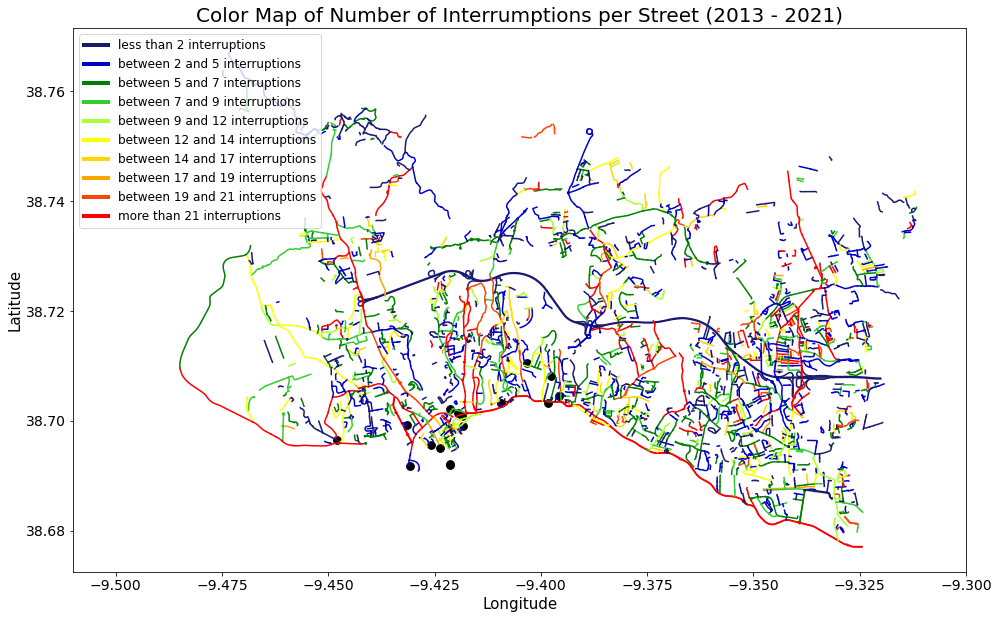

In [10]:
color_dict = {'0.0': 'midnightblue',
              '0.1': 'mediumblue',
              '0.2': 'green',
              '0.3': 'limegreen',
              '0.4': 'greenyellow',
              '0.5': 'yellow',
              '0.6': 'gold',
              '0.7': 'orange',
              '0.8': 'orangered',
              '0.9': 'red',
              '1.0': 'red'}

plt.figure(figsize = (16,10))
plt.xlabel('Longitude', fontsize = 15)
plt.ylabel('Latitude', fontsize = 15)
plt.title('Color Map of Number of Interrumptions per Street (2013 - 2021)', fontsize = 20)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.xlim([-9.51,-9.3])

custom_lines = [Line2D([0], [0], color = 'midnightblue', lw=4),
                Line2D([0], [0], color = 'mediumblue', lw=4),
                Line2D([0], [0], color = 'green', lw=4),
                Line2D([0], [0], color = 'limegreen', lw=4),
                Line2D([0], [0], color = 'greenyellow', lw=4),
                Line2D([0], [0], color = 'yellow', lw=4),
                Line2D([0], [0], color = 'gold', lw=4),
                Line2D([0], [0], color = 'orange', lw=4),
                Line2D([0], [0], color = 'orangered', lw=4),
                Line2D([0], [0], color = 'red', lw=4)]

for i in range(0,len(streets_1)):
    x, y = np.array(streets_1.iloc[i,1]).T
    color_id = streets_1.iloc[i,5]
    if color_id > 1.0:
        color_id = 1.0
    color = color_dict[str(color_id)]
    plt.plot(x,
             y,
             color = color)

plt.scatter(poidf['Longitude'], poidf['Latitude'], color = 'black', s = 60, label = 'POI')
plt.legend(custom_lines, ['less than 2 interruptions', 
                          'between 2 and 5 interruptions', 
                          'between 5 and 7 interruptions',
                          'between 7 and 9 interruptions',
                          'between 9 and 12 interruptions', 
                          'between 12 and 14 interruptions', 
                          'between 14 and 17 interruptions', 
                          'between 17 and 19 interruptions', 
                          'between 19 and 21 interruptions', 
                          'more than 21 interruptions'],
          fontsize = 12,
          loc = 'upper left')
plt.show()

There is a red street in the colormap (More than 21 interruptions) that crosses most of the POI data of the City. This street is named: **"Avenida 25 de Abril"**. Let's see the surroundings in a zoom of the colormap.

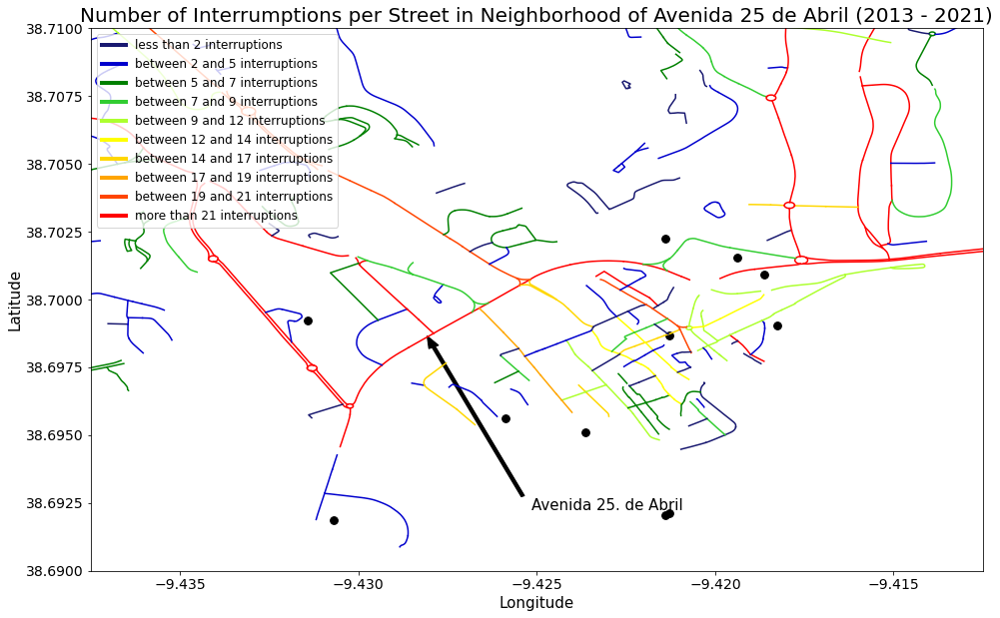

In [11]:
color_dict = {'0.0': 'midnightblue',
              '0.1': 'mediumblue',
              '0.2': 'green',
              '0.3': 'limegreen',
              '0.4': 'greenyellow',
              '0.5': 'yellow',
              '0.6': 'gold',
              '0.7': 'orange',
              '0.8': 'orangered',
              '0.9': 'red',
              '1.0': 'red'}

fig, ax = plt.subplots(figsize = (16,10))
plt.xlabel('Longitude', fontsize = 15)
plt.ylabel('Latitude', fontsize = 15)
plt.title('Number of Interrumptions per Street in Neighborhood of Avenida 25 de Abril (2013 - 2021)', fontsize = 20)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.xlim([-9.4375,-9.4125])
plt.ylim([38.69,38.71])

custom_lines = [Line2D([0], [0], color = 'midnightblue', lw=4),
                Line2D([0], [0], color = 'mediumblue', lw=4),
                Line2D([0], [0], color = 'green', lw=4),
                Line2D([0], [0], color = 'limegreen', lw=4),
                Line2D([0], [0], color = 'greenyellow', lw=4),
                Line2D([0], [0], color = 'yellow', lw=4),
                Line2D([0], [0], color = 'gold', lw=4),
                Line2D([0], [0], color = 'orange', lw=4),
                Line2D([0], [0], color = 'orangered', lw=4),
                Line2D([0], [0], color = 'red', lw=4)]

for i in range(0,len(streets_1)):
    x, y = np.array(streets_1.iloc[i,1]).T
    color_id = streets_1.iloc[i,5]
    if color_id > 1.0:
        color_id = 1.0
    color = color_dict[str(color_id)]
    plt.plot(x,
             y,
             color = color)

plt.scatter(poidf['Longitude'], poidf['Latitude'], color = 'black', s = 60, label = 'POI')
plt.arrow(-9.42789+0.0025, 38.69875-0.006, -0.0025, 0.0055, width = 0.0001, color = 'black')
ax.text(-9.42789+0.00275, 38.69875-0.0065, 'Avenida 25. de Abril', style = 'normal', fontsize = 15)

plt.legend(custom_lines, ['less than 2 interruptions', 
                          'between 2 and 5 interruptions', 
                          'between 5 and 7 interruptions',
                          'between 7 and 9 interruptions',
                          'between 9 and 12 interruptions', 
                          'between 12 and 14 interruptions', 
                          'between 14 and 17 interruptions', 
                          'between 17 and 19 interruptions', 
                          'between 19 and 21 interruptions', 
                          'more than 21 interruptions'],
          fontsize = 12,
          loc = 'upper left')
plt.show()

Based in all the above, the street **Avenida 25. de Abril is chosen** to perform a local bus route optimization, based on our approach. This decision is supported by:
- This street has 29 street interventions, being one of the most intervened streets in Caiscais.
- This street is located in the area of touristic interest, near the POI data for tourism and sight-seeing.
- Due to its location, it is important to start with feasible algorithms and solutions for interventions in this area.

### (3) Optimization on a Single Street: Avenida 25. de Abril

Visualising the Avenida 25. de Abril street and its neighborhood we have the following **network**.

The area will be **represented by an ideal network**, where each street intersection will be a node, and the original length of each edge (segment between intersections per street) will be treated as a **"cost" which magnitud will be the euclidean distance**. Graphically, this is shown below.

<Figure size 432x288 with 0 Axes>

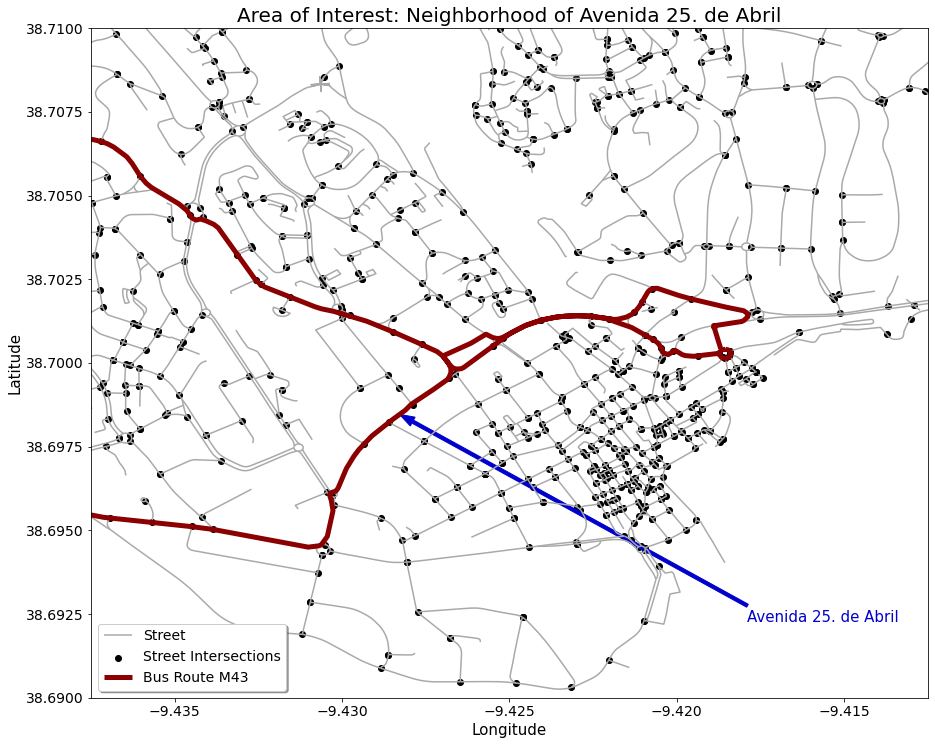

In [12]:
# Bus Routes
bus_routes = feed.routes_to_geojson(feed.routes.route_id.iloc[:], include_stops=True)
bus_rou_gp = gp.GeoDataFrame.from_features(bus_routes)

# Filtering the geojson data only to street of our interest and some area around it
interest_geo_data = geo_data.cx[-9.4375:-9.4125, 38.69:38.71]
interest_geo_data.plot(ax = ax)

# Adding the intersections between streets
def get_intersections(gdf, name, geom = 'geometry', crs = 4326):
    intersections_gdf = pd.DataFrame()
    name_2 = '{}_2'.format(name)
    crs_init = {'init': 'epsg:{}'.format(crs)}
    for index, row in gdf.iterrows():
        row_intersections = gdf.intersection(row[geom])
        row_intersection_points = row_intersections[row_intersections.geom_type == 'Point']
        row_intersections_df = pd.DataFrame(row_intersection_points)
        row_intersections_df[name_2] = row[name]
        row_intersections_df = row_intersections_df.join(gdf[name])
        intersections_gdf = row_intersections_df.append(intersections_gdf)

    intersections_gdf = intersections_gdf.rename(columns={0: geom})
    intersections_gdf['intersection'] = intersections_gdf.apply(lambda row: '-'.join(sorted([row[name_2], row[name]])), axis = 1)
    intersections_gdf = intersections_gdf.groupby('intersection').first()
    intersections_gdf = intersections_gdf.reset_index()
    intersections_gdf = gp.GeoDataFrame(intersections_gdf, geometry = 'geometry')
    intersections_gdf.crs = crs_init

    return intersections_gdf

route_intersections = get_intersections(interest_geo_data, 'Rua Id')

fig, ax = plt.subplots(figsize = (15,15))
route_fig = interest_geo_data.plot(ax = ax, color = 'darkgray', label = 'Street')
route_intersections.plot(ax = ax, color = 'black', label = 'Street Intersections')
bus_rou_gp[bus_rou_gp['route_id']=='M43'].plot(ax = ax, color = 'darkred', label = 'Bus Route M43', linewidth = 5)
ax.legend(shadow = True, fancybox = True, fontsize = 14)
plt.xlabel('Longitude', fontsize = 15)
plt.ylabel('Latitude', fontsize = 15)
plt.title('Area of Interest: Neighborhood of Avenida 25. de Abril', fontsize = 20)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.xlim([-9.4375,-9.4125])
plt.ylim([38.69,38.71])
plt.arrow(-9.42789+0.01, 38.69875-0.006, -0.01, 0.0055, width = 0.0001, color = 'mediumblue')
ax.text(-9.42789+0.01, 38.69875-0.0065, 'Avenida 25. de Abril', style = 'normal', fontsize = 15, color = 'mediumblue')
plt.show()

This neighborhood is represented virtually by a distance matrix where:
- Each entry (i,j) represents the euclidean distance between i and j (geospatial points)
- The nodes i, j are the street intersections.

This matrix is shown below.
- Matrix include the *distance* column as edge cost for the calculation of original shortest path between two points.
- *rewarded_distance* consider the proximity of edges from the bus stops into account and reduced the cost of edge as a reward

In [13]:

filtered_int_geo_data = geo_data.cx[-9.43756:-9.413442,38.691779:38.705018]
distance_matrix = gp.GeoDataFrame()
distance_matrix['rua_id'] = None
distance_matrix['start_coord'] = None
distance_matrix['end_coord'] = None
distance_matrix['distance'] = None

for index, row in filtered_int_geo_data.iterrows():
    
    coords = [(coords) for coords in list(row['geometry'].coords)]
    first_coord, last_coord = [ coords[i] for i in (0, -1) ]
    distance_matrix.at[index,'rua_id'] = row['Rua Id']
    distance_matrix.at[index,'start_coord'] = first_coord
    distance_matrix.at[index,'end_coord'] = last_coord
    distance_matrix.at[index,'distance'] = degrees2kilometers(row['geometry'].length)

coordinates = []
coordinates = distance_matrix.start_coord
geometry = [Point(point) for point in coordinates]
matrix = gp.GeoDataFrame(distance_matrix, crs="EPSG:4326", geometry=geometry)

#Finding out if bus stops are on edges

filtered_bus_stops = feed.stops
filtered_bus_stops = filtered_bus_stops[(filtered_bus_stops['stop_lat'] >= 38.691779) & (filtered_bus_stops['stop_lat'] <= 38.705018)]
filtered_bus_stops = filtered_bus_stops[(filtered_bus_stops['stop_lon'] >= -9.43756) & (filtered_bus_stops['stop_lon'] <= -9.413442)]
geometry = [Point(xy) for xy in zip(filtered_bus_stops.stop_lon, filtered_bus_stops.stop_lat)]
df_bus_stops = filtered_bus_stops.drop(['stop_lon', 'stop_lat'], axis=1)
bus_stops_gj = gp.GeoDataFrame(df_bus_stops, crs="EPSG:4326", geometry=geometry)


filtered_int_geo_data.reset_index(drop=True, inplace=True)
bus_stops_gj.reset_index(drop=True, inplace=True)

# functions to find out miinimum distance of bus stops from an edge

def closest_line(point):
    # get distances
    distance_list = [line.distance(point) for line in filtered_int_geo_data.geometry]
    shortest_distance = min(distance_list) # find the line closest to the point
    return(distance_list.index(shortest_distance), # return the closest line
           shortest_distance) # return the distance to that line

point = bus_stops_gj.geometry[0]
distance_list = [line.distance(point) for line in filtered_int_geo_data.geometry]

shortest_distance = min(distance_list)
distance_list.index(shortest_distance)

# Update Matrix data frame with the availibility of bus stops on edges

matrix['bus_stop']=0
for bus_stop in bus_stops_gj.geometry:
    row_number, min_distance = closest_line(bus_stop)
    matrix.at[row_number,'bus_stop'] = 1
    
matrix['rewarded_distance']=matrix['distance']

for index, row in matrix.iterrows():
    if row['bus_stop']==1:
        matrix.at[index,'rewarded_distance']=row['distance']*0.6
        
matrix.head()

,rua_id,start_coord,end_coord,distance,geometry,bus_stop,rewarded_distance
16,2234440,"(-9.4222869515, 38.6946873785)","(-9.4229873312, 38.6946014132)",0.103284,POINT (-9.42229 38.69469),0.0,0.103284
20,2234510,"(-9.431728345, 38.7046304825)","(-9.431427907, 38.7042191136)",0.080956,POINT (-9.43173 38.70463),0.0,0.080956
21,2234526,"(-9.4254443651, 38.7020453339)","(-9.4257524552, 38.70259937)",0.070491,POINT (-9.42544 38.70204),0.0,0.070491
30,1667884,"(-9.422558909, 38.7011463174)","(-9.4225677745, 38.7014056868)",0.044901,POINT (-9.42256 38.70115),0.0,0.044901
66,2115673,"(-9.4294039633, 38.702505643)","(-9.4291971147, 38.7025875553)",0.107366,POINT (-9.42940 38.70251),0.0,0.107366


 Implementation of Dijkstra's Aglorithm for finding the shortest path in the street of Cascais.
 -  We created class *Graph* to add edges with there cost, which the algorithm will used to find the shortest path between given nodes.
 
 
 - We focused on 'Avenida 25. de Abril' street as it had more intrruptions, and Point of Interests (POIs) are higher in this area. Our model find the original shortest distance before we introduce an artificial intrruption by revoing an edge and re-route the path to find next feasible shortest path.

In [14]:

# converting GeodataFrame to pandas DataFrame

rtm = matrix.copy(deep=True)

rtm1 = pd.DataFrame(rtm[['start_coord','end_coord','distance']])
rtm1['distance'] = pd.to_numeric(rtm1['distance'],errors = 'coerce').round(5)

# converting to list for implementation of SPT Algorithm
edges = list(rtm1.itertuples(index=False, name=None))

# Defining the class graph class for adding edges
class Graph():
    def __init__(self):
        """
        self.edges is a dict of all possible next nodes
        e.g. {'X': ['A', 'B', 'C', 'E'], ...}
        self.weights has all the weights between two nodes,
        with the two nodes as a tuple as the key
        e.g. {('X', 'A'): 7, ('X', 'B'): 2, ...}
        """
        self.edges = defaultdict(list)
        self.weights = {}
    
    def add_edge(self, from_node, to_node, weight):
        # Note: assumes edges are bi-directional
        self.edges[from_node].append(to_node)
        self.edges[to_node].append(from_node)
        self.weights[(from_node, to_node)] = weight
        self.weights[(to_node, from_node)] = weight
        
        
# Dijsktra algorithm to calculate the shortest path
def dijsktra(graph, initial, end):
    # shortest paths is a dict of nodes
    # whose value is a tuple of (previous node, weight)
    shortest_paths = {initial: (None, 0)}
    current_node = initial
    visited = set()
    
    while current_node != end:
        visited.add(current_node)
        destinations = graph.edges[current_node]
        weight_to_current_node = shortest_paths[current_node][1]

        for next_node in destinations:
            weight = graph.weights[(current_node, next_node)] + weight_to_current_node
            if next_node not in shortest_paths:
                shortest_paths[next_node] = (current_node, weight)
            else:
                current_shortest_weight = shortest_paths[next_node][1]
                if current_shortest_weight > weight:
                    shortest_paths[next_node] = (current_node, weight)
        
        next_destinations = {node: shortest_paths[node] for node in shortest_paths if node not in visited}
        if not next_destinations:
            return "Route Not Possible"
        # next node is the destination with the lowest weight
        current_node = min(next_destinations, key=lambda k: next_destinations[k][1])
    
    # Work back through destinations in shortest path
    path = []
    while current_node is not None:
        path.append(current_node)
        next_node = shortest_paths[current_node][0]
        current_node = next_node
    # Reverse path
    path = path[::-1]
    return path

# Adding edges to graph

graph = Graph()
for edge in edges:
    graph.add_edge(*edge)
    
# Finding the shortest path between start and end coordinates - Original distance.

shortest_route = dijsktra(graph,(-9.430754341, 38.694451877),(-9.4209469339, 38.7008490124))

# Plotting the obtainied shortest path between start coordinate:(-9.430754341, 38.694451877) and 
#end coordinate:(-9.4209469339, 38.7008490124)

polygon = LineString(shortest_route)
gdf = gp.GeoDataFrame(index=[0], crs='epsg:4326', geometry=[polygon])
gdf.explore()


We removed an edge and our model calculated the shortest distance, which is indicated below,

- Red line indicate the original route

- Blue line indicate the route it took in case of intrruption.

In [15]:
# nodes to delete
removed_section = [(-9.4263550367, 38.6998746211),(-9.425491438, 38.7005146919)]

rtm2 = pd.DataFrame(rtm[['start_coord','end_coord','rewarded_distance']])
rtm2['rewarded_distance'] = pd.to_numeric(rtm2['rewarded_distance'],errors = 'coerce').round(5)
rtm_test = rtm2.copy(deep=True)

rtm_test.dropna(inplace = True)

# removed the selected sections
i = removed_section[0]
j = removed_section[1]
rtm_test = rtm_test[(rtm_test['start_coord']!=i)&(rtm_test['end_coord']!=j)]

# convert the panda Dataframe to list
edges_test = list(rtm_test.itertuples(index=False, name=None))

graph_test = Graph()
for edge_test in edges_test:
    graph_test.add_edge(*edge_test)
    
shortest_route_test = dijsktra(graph_test,(-9.4268123772, 38.6995415008),(-9.425188174, 38.7007340757))

polygon_test = LineString(shortest_route_test)
gdf_test = gp.GeoDataFrame(index=[0], crs='epsg:4326', geometry=[polygon_test])
m_test = gdf_test.explore(color="Blue")

gdf.explore(m=m_test,color="Red",legend = True)

### (3) Conclusion
With the shown approach we have proven that our believe of devide and conquer works. Considering the structure of a network that consist of 'Avenida 25. de Abril' and bus route M43, the [Dijkstra's exact algorithm](https://en.wikipedia.org/wiki/Dijkstra%27s_algorithm) for shortest path problem inclusing rewards to closeness to formal bus stops, and penalties for bus deviations is able to provide an optimal solution. This instance represents the first steps towards a city-scale problem. As this is going to be a NP-Hard problem because of the magnitude and the number of bus-routes to optimize, the next steps should consider the implementation of *Heuristics* such as [Orinteering algorithm](https://www.cs.cmu.edu/~avrim/Papers/orienteering-sicomp.pdf

Our product is a methology with which we convinced that Cascais Municipality can thrive in preserving the quality of publich transport, by means of Data Science and Operational Research.

## 🖼️ Visualisations
Copy here the most important visualizations (graphs, charts, maps, images, etc). You can refer to them in the Executive Summary.

Technical note: If not all the visualisations are visible, you can still include them as an image or link - in this case please upload them to your own repository.

## 👓 References
List all of the external links (even if they are already linked above), such as external datasets, papers, blog posts, code repositories and any other materials.

## ⏭️ Appendix
Add here any code, images or text that you still find relevant, but that was too long to include in the main report. This section is optional.
